# Facebook Prophet - Short term traffic predictions - ASPM Regional roads

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Init" data-toc-modified-id="Init-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Init</a></span><ul class="toc-item"><li><span><a href="#Init-functions" data-toc-modified-id="Init-functions-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Init functions</a></span></li></ul></li><li><span><a href="#Read-and-prepare-data" data-toc-modified-id="Read-and-prepare-data-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Read and prepare data</a></span></li><li><span><a href="#Model-initializer" data-toc-modified-id="Model-initializer-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Model initializer</a></span></li><li><span><a href="#Fit-model-and-forecast" data-toc-modified-id="Fit-model-and-forecast-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Fit model and forecast</a></span><ul class="toc-item"><li><span><a href="#Cross-validation" data-toc-modified-id="Cross-validation-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>Cross validation</a></span></li><li><span><a href="#Save-results-to-file" data-toc-modified-id="Save-results-to-file-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Save results to file</a></span></li><li><span><a href="#Evaulate-results" data-toc-modified-id="Evaulate-results-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>Evaulate results</a></span></li></ul></li><li><span><a href="#Example-of-model-components" data-toc-modified-id="Example-of-model-components-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Example of model components</a></span><ul class="toc-item"><li><span><a href="#Plot-model's-components" data-toc-modified-id="Plot-model's-components-5.1"><span class="toc-item-num">5.1&nbsp;&nbsp;</span>Plot model's components</a></span></li><li><span><a href="#Plot-forecast" data-toc-modified-id="Plot-forecast-5.2"><span class="toc-item-num">5.2&nbsp;&nbsp;</span>Plot forecast</a></span></li></ul></li></ul></div>

## Init

In [1]:
import pandas as pd
import numpy as np

from fbprophet import Prophet
from fbprophet.diagnostics import cross_validation, performance_metrics
from fbprophet.plot import plot_cross_validation_metric

import plotly.graph_objects as go

import os


root_dir = "../"

data_dir = f"{root_dir}data/dataframes/per_location/"

locations = [
    "Rabuiese Valico Uscita", "Rabuiese Valico Ingresso", 
    "Fernetti Valico Uscita", "Fernetti Valico Ingresso", 
    "Prosecco Direzione TS", "Prosecco Direzione VE",
    "A34 Ovest dir- Villesse", "A34 Est dir- Gorizia"
]
location_template_feather = data_dir + "{}.feather"


export_images_dir = root_dir + "exports/D4.4/"
try:
    # Create target Directory
    os.makedirs(export_images_dir)
    print(f"Directory {export_images_dir} Created ") 
except FileExistsError:
    print(f"Directory {export_images_dir} already exists")

Directory ../exports/D4.4/ already exists


### Init functions

In [2]:
def plot(
    fig, name=False, width=900, height=400, 
    margin_l=50, margin_r=0, margin_t=0, margin_b=40,
):
    fig.update_layout(
        template="none",
        width=width,
        height=height,
        margin = dict(
            l=margin_l, 
            r=margin_r, 
            t=margin_t,
            b=margin_b
        )
    )
    fig.show()
    if name:
        fig.write_image(f"{export_images_dir}{name}.png")

## Read and prepare data

In [3]:
locations_dfs = {}
for location in locations:
    file_name = location_template_feather.format(location.replace(" ", "_").lower())
    locations_dfs[location] = pd.read_feather(file_name).rename(columns={
        "timestamp": "ds",
        "count": "y"
    })

In [4]:
fig = go.Figure(data=[
    go.Scatter(x=locations_dfs[location]["ds"], y=locations_dfs[location]["y"], name=location) for location in locations
])
fig.show()

## Model initializer
Model initializer is method that initializes Facebook Prophet model, adds custom seasonalities, additional regressors, holidays...

In [5]:
def model_initializer():
    model = Prophet(daily_seasonality=False)
    model.add_seasonality(name='mon', period=1, fourier_order=7, condition_name='mon')
    model.add_seasonality(name='tue', period=1, fourier_order=7, condition_name='tue')
    model.add_seasonality(name='wed', period=1, fourier_order=7, condition_name='wed')
    model.add_seasonality(name='thu', period=1, fourier_order=7, condition_name='thu')
    model.add_seasonality(name='fri', period=1, fourier_order=7, condition_name='fri')
    model.add_seasonality(name='sat', period=1, fourier_order=7, condition_name='sat')
    model.add_seasonality(name='sun', period=1, fourier_order=7, condition_name='sun')
    
    return model

def prepare_data(d):    
    d["mon"] = d["ds"].dt.dayofweek == 0
    d["tue"] = d["ds"].dt.dayofweek == 1
    d["wed"] = d["ds"].dt.dayofweek == 2
    d["thu"] = d["ds"].dt.dayofweek == 3
    d["fri"] = d["ds"].dt.dayofweek == 4
    d["sat"] = d["ds"].dt.dayofweek == 5
    d["sun"] = d["ds"].dt.dayofweek == 6
    
for location in locations:
    prepare_data(locations_dfs[location])

In [6]:
for location in locations:
    display(locations_dfs[location].head())

,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,25.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,17.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,15.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,10.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,21.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,19.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,11.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,24.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,26.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,46.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,57.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,50.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,44.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,37.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,64.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,2.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,2.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,3.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,8.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,10.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,6.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,4.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,4.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,3.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,2.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,94.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,76.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,68.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,101.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,165.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,74.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,71.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,63.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,87.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,107.0,False,True,False,False,False,False,False


,ds,y,mon,tue,wed,thu,fri,sat,sun
0,2015-03-10 00:00:00,31.0,False,True,False,False,False,False,False
1,2015-03-10 01:00:00,22.0,False,True,False,False,False,False,False
2,2015-03-10 02:00:00,21.0,False,True,False,False,False,False,False
3,2015-03-10 03:00:00,13.0,False,True,False,False,False,False,False
4,2015-03-10 04:00:00,36.0,False,True,False,False,False,False,False


## Fit model and forecast
### Cross validation

In [7]:
from multiprocessing import Pool

def f(x):
    location, data = x
    print(location)
    # Init and fit model
    model = model_initializer()
    model.fit(data.copy())
    

    return (location, cross_validation(model, initial='1200 days', period='10 days', horizon='1 days'))

pool = Pool(processes=7)
 
result = pool.map(f, list(zip(locations, locations_dfs.values())))

Rabuiese Valico Uscita
A34 Ovest dir- Villesse
Fernetti Valico Ingresso
Fernetti Valico Uscita
Rabuiese Valico Ingresso
Prosecco Direzione TS
Prosecco Direzione VE


INFO:fbprophet:Making 25 forecasts with cutoffs between 2018-06-29 21:00:00 and 2019-07-25 21:00:00
INFO:fbprophet:Making 25 forecasts with cutoffs between 2018-06-29 21:00:00 and 2019-07-25 21:00:00
INFO:fbprophet:Making 21 forecasts with cutoffs between 2018-06-30 12:00:00 and 2019-01-16 12:00:00
INFO:fbprophet:Making 21 forecasts with cutoffs between 2018-06-29 07:00:00 and 2019-01-16 12:00:00
INFO:fbprophet:Making 37 forecasts with cutoffs between 2018-06-30 23:00:00 and 2019-08-30 23:00:00
INFO:fbprophet:Making 33 forecasts with cutoffs between 2018-06-30 23:00:00 and 2019-08-06 00:00:00
INFO:fbprophet:Making 34 forecasts with cutoffs between 2018-06-26 08:00:00 and 2019-08-06 00:00:00


A34 Est dir- Gorizia


INFO:fbprophet:Making 37 forecasts with cutoffs between 2018-06-26 02:00:00 and 2019-08-30 23:00:00


In [8]:
results_df = pd.DataFrame()
for location, d in result:
    data = d.copy()
    data["location"] = location
    results_df = pd.concat([results_df, data])
results_df

,ds,yhat,yhat_lower,yhat_upper,y,cutoff,location
0,2018-06-26 09:00:00,629.539163,424.233784,844.664116,704.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
1,2018-06-26 10:00:00,667.000336,460.726763,867.113117,721.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
2,2018-06-26 11:00:00,709.022172,514.216210,911.779520,752.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
3,2018-06-26 12:00:00,769.748439,567.317790,980.316161,760.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
4,2018-06-26 13:00:00,786.451550,579.288115,987.371736,840.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
5,2018-06-26 14:00:00,738.238252,532.054411,934.429409,794.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
6,2018-06-26 15:00:00,735.846443,529.866244,939.527091,730.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
7,2018-06-26 16:00:00,821.081331,599.551770,1011.161871,880.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
8,2018-06-26 17:00:00,862.068675,636.360742,1058.848240,978.0,2018-06-26 08:00:00,Rabuiese Valico Uscita
9,2018-06-26 18:00:00,772.432349,571.805406,976.351618,849.0,2018-06-26 08:00:00,Rabuiese Valico Uscita


### Save results to file

In [9]:
results_df.reset_index(drop=True).to_feather("regional_roads_results.feather")

### Evaulate results

In [10]:
results_df["yhat"] = results_df["yhat"].clip(0)

In [11]:
results_df["hour"] = results_df["ds"].dt.hour
results_df["abs_error"] = (results_df["y"] - results_df["yhat"]).abs()

In [12]:
results_df.pivot_table(columns="location", index="hour", values="abs_error", aggfunc=np.mean).round(1)

location,A34 Est dir- Gorizia,A34 Ovest dir- Villesse,Fernetti Valico Ingresso,Fernetti Valico Uscita,Prosecco Direzione TS,Prosecco Direzione VE,Rabuiese Valico Ingresso,Rabuiese Valico Uscita
hour,,,,,,,,
0,47.4,44.8,40.1,33.6,53.4,98.8,56.2,66.5
1,42.4,44.4,31.2,31.0,70.7,118.4,65.5,67.7
2,39.4,41.6,31.3,29.0,58.9,105.2,76.2,73.9
3,45.9,40.3,40.0,26.1,73.1,106.9,79.7,76.0
4,46.5,36.9,33.2,23.8,72.4,99.1,66.2,67.3
5,43.4,44.2,50.1,31.7,76.5,93.0,70.5,75.0
6,45.2,51.8,65.1,41.8,78.2,101.2,63.3,79.3
7,50.9,79.9,105.1,49.3,123.6,115.8,86.2,114.6
8,68.2,81.5,88.6,69.7,137.9,147.3,91.8,167.8


In [13]:
results_df.pivot_table(columns="location", values="abs_error", aggfunc=np.mean).round(1)

location,A34 Est dir- Gorizia,A34 Ovest dir- Villesse,Fernetti Valico Ingresso,Fernetti Valico Uscita,Prosecco Direzione TS,Prosecco Direzione VE,Rabuiese Valico Ingresso,Rabuiese Valico Uscita
abs_error,59.3,59.3,74.8,61.6,85.4,119.2,99.6,153.3


In [14]:
data = results_df.groupby(["location", "hour"])[["abs_error"]].mean().reset_index()
fig = go.Figure()
for location in locations:
    temp = data[data["location"] == location]
    fig.add_trace(go.Scatter(x=temp["hour"], y=temp["abs_error"],
                        mode='lines',
                        name=location))
    
plot(fig)

In [16]:
error_metrics = pd.DataFrame()
for location, d in result:
    data = d.copy()
    data["location"] = location
    print(location)
    err = performance_metrics(data, rolling_window=1)
    err["location"] = location
    error_metrics = pd.concat([error_metrics, err])
#     display(err)

Rabuiese Valico Uscita
Rabuiese Valico Ingresso
Fernetti Valico Uscita
Fernetti Valico Ingresso


/home/tomaz/anaconda3/envs/vessel_calls/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


/home/tomaz/anaconda3/envs/vessel_calls/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


/home/tomaz/anaconda3/envs/vessel_calls/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain t

Prosecco Direzione TS
Prosecco Direzione VE
A34 Ovest dir- Villesse
A34 Est dir- Gorizia


/home/tomaz/anaconda3/envs/vessel_calls/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


/home/tomaz/anaconda3/envs/vessel_calls/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




To get any information from the bellow charts, select smaller time periods on dynamic plotly charts (may not work on preview).

In [18]:
for location, d in result:
    data = d.copy()
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=data["ds"], y=data["y"],
                        mode='lines',
                        name="Ground truth"))
    fig.add_trace(go.Scatter(x=data["ds"], y=data["yhat"].clip(0),
                        mode='lines',
                        name="Forecast"))

    fig.update_layout(
        title=location
    )
    plot(fig)

In [19]:
temp = error_metrics.copy()
temp["mdape"] *= 100
temp = temp.round(2)
temp[["location", "mae", "rmse", "mdape"]]

,location,mae,rmse,mdape
0,Rabuiese Valico Uscita,182.29,241.04,89.36
0,Rabuiese Valico Ingresso,121.06,171.73,41.01
0,Fernetti Valico Uscita,80.41,98.70,73.49
0,Fernetti Valico Ingresso,74.78,114.67,19.48
0,Prosecco Direzione TS,89.46,129.86,13.29
0,Prosecco Direzione VE,119.46,190.51,14.83
0,A34 Ovest dir- Villesse,59.35,91.04,14.39
0,A34 Est dir- Gorizia,59.58,89.59,16.45


## Example of model components

In [73]:
# Init and fit model
model = model_initializer()
model.fit(locations_dfs['A34 Est dir- Gorizia'])

# Prepare future dataframe, with periods=horizon_days * 1d/freq --> (365*24)
future = model.make_future_dataframe(periods=365*24, freq="1h")
prepare_data(future)

# Predict and display forecasts tail
forecast = model.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
48019,2020-08-30 19:00:00,551.730512,-27.957427,1104.933753
48020,2020-08-30 20:00:00,435.383774,-136.665131,986.027988
48021,2020-08-30 21:00:00,324.483742,-258.010494,868.885705
48022,2020-08-30 22:00:00,253.939376,-332.768428,814.024805
48023,2020-08-30 23:00:00,213.628421,-362.399750,765.265449


### Plot model's components

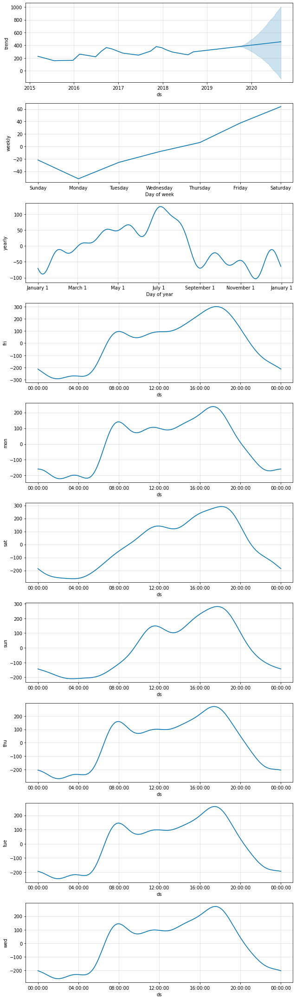

In [74]:
model.plot_components(forecast);

### Plot forecast

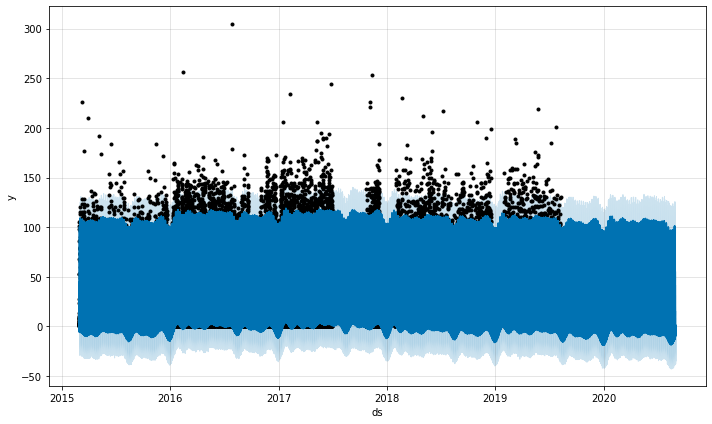

In [20]:
model.plot(forecast);